<a href="https://colab.research.google.com/github/wing787/books_Python_for_Geospatial_Data_Analysis/blob/main/ch_7/ch7_geopandas_PopulationMap.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
# ランタイム切断後に再度実行
# !pip install geopandas

In [2]:
import requests
import sys
import pandas as pd
import geopandas as gpd
import folium as fm

In [3]:
print("Python Version", sys.version)
print("requests version:", requests.__version__)
print("pandas version:", pd.__version__)
print("geopandas version:", gpd.__version__)
print("folium version:", fm.__version__)

Python Version 3.10.12 (main, Jun 11 2023, 05:26:28) [GCC 11.4.0]
requests version: 2.31.0
pandas version: 1.5.3
geopandas version: 0.13.2
folium version: 0.14.0


In [4]:
!wget ftp://ftp2.census.gov/geo/tiger/TIGER2019/TRACT/tl_2019_06_tract.zip

--2023-10-05 00:54:23--  ftp://ftp2.census.gov/geo/tiger/TIGER2019/TRACT/tl_2019_06_tract.zip
           => ‘tl_2019_06_tract.zip’
Resolving ftp2.census.gov (ftp2.census.gov)... 148.129.75.35, 2610:20:2010:a09:1000:0:9481:4b23
Connecting to ftp2.census.gov (ftp2.census.gov)|148.129.75.35|:21... connected.
Logging in as anonymous ... Logged in!
==> SYST ... done.    ==> PWD ... done.
==> TYPE I ... done.  ==> CWD (1) /geo/tiger/TIGER2019/TRACT ... done.
==> SIZE tl_2019_06_tract.zip ... 29388806
==> PASV ... done.    ==> RETR tl_2019_06_tract.zip ... done.
Length: 29388806 (28M) (unauthoritative)

tl_2019_06_tract.zi 100%[===================>]  28.03M   371KB/s    in 60s     

2023-10-05 00:55:25 (480 KB/s) - ‘tl_2019_06_tract.zip’ saved [29388806]



In [5]:
!wget ftp://ftp2.census.gov/geo/tiger/TIGER2019/COUNTY/tl_2019_us_county.zip

--2023-10-05 00:55:25--  ftp://ftp2.census.gov/geo/tiger/TIGER2019/COUNTY/tl_2019_us_county.zip
           => ‘tl_2019_us_county.zip’
Resolving ftp2.census.gov (ftp2.census.gov)... 148.129.75.35, 2610:20:2010:a09:1000:0:9481:4b23
Connecting to ftp2.census.gov (ftp2.census.gov)|148.129.75.35|:21... connected.
Logging in as anonymous ... Logged in!
==> SYST ... done.    ==> PWD ... done.
==> TYPE I ... done.  ==> CWD (1) /geo/tiger/TIGER2019/COUNTY ... done.
==> SIZE tl_2019_us_county.zip ... 79237324
==> PASV ... done.    ==> RETR tl_2019_us_county.zip ... done.
Length: 79237324 (76M) (unauthoritative)

tl_2019_us_county.z 100%[===================>]  75.57M   525KB/s    in 2m 35s  

2023-10-05 00:58:01 (500 KB/s) - ‘tl_2019_us_county.zip’ saved [79237324]



In [6]:
# unzip
import zipfile

with zipfile.ZipFile('/content/tl_2019_06_tract.zip','r') as inputFile:
    inputFile.extractall()

with zipfile.ZipFile('/content/tl_2019_us_county.zip','r') as inputFile:
    inputFile.extractall()

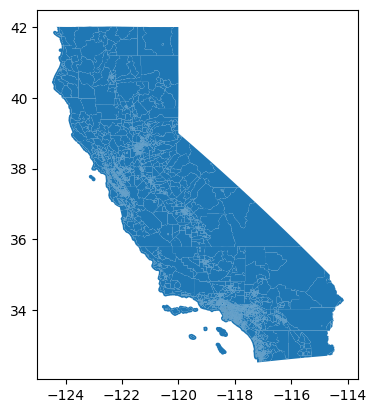

In [7]:
ca_tracts = gpd.read_file('/content/tl_2019_06_tract.shp')
ca_tracts.plot();

In [8]:
url = 'https://api.census.gov/data/2019/acs/acs1/profile?get=NAME,DP03_0001E&'\
'for=metropolitan%20statistical%20area/micropolitan%20statistical%20area:*'
df = pd.read_json(url)
df.to_csv('sample.csv')

In [9]:
# 2010年国勢調査の参照URLへのリクエストを構築
HOST = "https://api.census.gov/data"
year = "2010"
dataset = "dec/sf1"
base_url = "/".join([HOST, year, dataset])
predicates = {}
get_vars = ["LSAD_NAME", "P001001"]
predicates["get"] = ",".join(get_vars)
predicates["for"] = "tract:*"
predicates["in"] = "state:06"
r = requests.get(base_url, params=predicates)

In [10]:
print(r.json()[0])

['LSAD_NAME', 'P001001', 'state', 'county', 'tract']


In [11]:
tract_name = ["tract_name", "tract_pop", "state_fips", "country_fips", "tract_fips"]
tract_df = pd.DataFrame(columns=tract_name, data=r.json()[1:])
tract_df["tract_pop"] = tract_df["tract_pop"].astype(int)

tract_df.head()

,tract_name,tract_pop,state_fips,country_fips,tract_fips
0,Census Tract 4340.04,2796,06,037,434004
1,Census Tract 4600,4851,06,037,460000
2,Census Tract 4602,5315,06,037,460200
3,Census Tract 4603.01,4638,06,037,460301
4,Census Tract 4603.02,4442,06,037,460302


In [12]:
onecountry_tract_df = tract_df.loc[tract_df['country_fips'] == '037'].copy()
onecountry_tract_df

,tract_name,tract_pop,state_fips,country_fips,tract_fips
0,Census Tract 4340.04,2796,06,037,434004
1,Census Tract 4600,4851,06,037,460000
2,Census Tract 4602,5315,06,037,460200
3,Census Tract 4603.01,4638,06,037,460301
4,Census Tract 4603.02,4442,06,037,460302
...,...,...,...,...,...
7739,Census Tract 9302,546,06,037,930200
7740,Census Tract 9303.01,886,06,037,930301
7762,Census Tract 9304.01,2471,06,037,930401
7763,Census Tract 9800.01,0,06,037,980001


In [13]:
onecountry_tract_df['tract_fips'] = onecountry_tract_df['tract_fips'].str.ljust(6, '0')
onecountry_tract_df['geoid'] = onecountry_tract_df['state_fips'] + onecountry_tract_df['country_fips'] + onecountry_tract_df['tract_fips']
onecountry_tract_df

,tract_name,tract_pop,state_fips,country_fips,tract_fips,geoid
0,Census Tract 4340.04,2796,06,037,434004,06037434004
1,Census Tract 4600,4851,06,037,460000,06037460000
2,Census Tract 4602,5315,06,037,460200,06037460200
3,Census Tract 4603.01,4638,06,037,460301,06037460301
4,Census Tract 4603.02,4442,06,037,460302,06037460302
...,...,...,...,...,...,...
7739,Census Tract 9302,546,06,037,930200,06037930200
7740,Census Tract 9303.01,886,06,037,930301,06037930301
7762,Census Tract 9304.01,2471,06,037,930401,06037930401
7763,Census Tract 9800.01,0,06,037,980001,06037980001


In [14]:
onecountry_tract_df.count()

tract_name      2346
tract_pop       2346
state_fips      2346
country_fips    2346
tract_fips      2346
geoid           2346
dtype: int64

In [15]:
ca_tracts.info

<bound method DataFrame.info of      STATEFP COUNTYFP TRACTCE        GEOID     NAME              NAMELSAD  \
0         06      037  139301  06037139301  1393.01  Census Tract 1393.01   
1         06      037  139302  06037139302  1393.02  Census Tract 1393.02   
2         06      037  139502  06037139502  1395.02  Census Tract 1395.02   
3         06      037  139600  06037139600     1396     Census Tract 1396   
4         06      037  139701  06037139701  1397.01  Census Tract 1397.01   
...      ...      ...     ...          ...      ...                   ...   
8052      06      001  443001  06001443001  4430.01  Census Tract 4430.01   
8053      06      001  443002  06001443002  4430.02  Census Tract 4430.02   
8054      06      001  443102  06001443102  4431.02  Census Tract 4431.02   
8055      06      001  443301  06001443301  4433.01  Census Tract 4433.01   
8056      06      037  137501  06037137501  1375.01  Census Tract 1375.01   

      MTFCC FUNCSTAT    ALAND  AWATER     I

In [16]:
attr_joined_df = pd.merge(ca_tracts, onecountry_tract_df, left_on='GEOID', right_on='geoid')
attr_joined_df.count()

STATEFP         2345
COUNTYFP        2345
TRACTCE         2345
GEOID           2345
NAME            2345
NAMELSAD        2345
MTFCC           2345
FUNCSTAT        2345
ALAND           2345
AWATER          2345
INTPTLAT        2345
INTPTLON        2345
geometry        2345
tract_name      2345
tract_pop       2345
state_fips      2345
country_fips    2345
tract_fips      2345
geoid           2345
dtype: int64

In [17]:
ca_prj = attr_joined_df.to_crs(epsg=4326)
center_x = (ca_prj.bounds.minx.mean() + ca_prj.bounds.maxx.mean()) / 2
center_y = (ca_prj.bounds.miny.mean() + ca_prj.bounds.maxy.mean()) / 2
print(f'The center of the data file is located at {center_x} {center_y}')

The center of the data file is located at -118.25227698379531 34.065441963113


In [18]:
m = fm.Map(location=[center_y, center_x], zoom_start=10)

# 調査対象の地域ブロックグループを地図に追加
fm.Choropleth(
    geo_data=ca_prj,
    data=ca_prj,
    columns=['tract_pop', 'ALAND'],
    key_on='feature.properties.tract_pop',
    fill_color='YlGnBu',
    name='Population Density',
    legend_name='Population Density'
).add_to(m)
m

In [19]:
# 国勢調査区の面積（平方キロメートル）用のカラムを作成
ca_prj['AreaLandKM2'] = (ca_prj['ALAND'] * .000001)
ca_prj[['geoid', 'TRACTCE', 'ALAND', 'AWATER', 'AreaLandKM2']].head()
ca_prj['ppl_perKM2'] = (ca_prj['tract_pop'] / ca_prj['AreaLandKM2'])
ca_prj[['geoid', 'TRACTCE', 'tract_pop', 'AreaLandKM2', 'ppl_perKM2']].head(16)

,geoid,TRACTCE,tract_pop,AreaLandKM2,ppl_perKM2
0,06037139301,139301,4462,2.865657,1557.060039
1,06037139302,139302,4422,0.338289,13071.663578
2,06037139502,139502,3007,1.047548,2870.512855
3,06037139600,139600,4633,2.477482,1870.043859
4,06037139701,139701,4920,3.396396,1448.594334
5,06037139801,139801,3539,3.665744,965.424754
6,06037143400,143400,5881,1.738504,3382.793482
7,06037143500,143500,4708,1.191719,3950.595736
8,06037181000,181000,6144,4.107041,1495.967535
9,06037181500,181500,3812,1.094424,3483.110750


In [20]:
m = fm.Map(location=[center_y, center_x], zoom_start=10)

# 地図にStudy Area Block Groupsを追加
fm.Choropleth(
  geo_data=ca_prj,
  data=ca_prj,
  columns=['TRACTCE', 'ppl_perKM2'],
  key_on='feature.properties.TRACTCE',
  fill_color='YlGnBu',
  name='Population Density',
  legend_name='Population Density'
).add_to(m)
m